<img src="https://raw.githubusercontent.com/drjonshiach/Chaos-with-Python/master/Images/MMU_logo.png" width=150 align="right"/>
<img src="https://raw.githubusercontent.com/drjonshiach/Chaos-with-Python/master/Images/python_logo.png" width="150" align="right"/>


# An Introduction to Chaos with Python


---

<table align="center">
    <tr>
        <td align="left">
            <span style="font-weight:normal">
                <b>Dr Jon Shiach</b> <br><br>
                Senior Lecturer <br>
                Department of Computing and Mathematics<br>
                Manchester Metropolitan University<br> 
                Email: <a href="mailto:j.shiach@mmu.ac.uk">j.shiach@mmu.ac.uk</a>
            </span>
        </td>
        <td>
            <img width="100" height="100" src="https://raw.githubusercontent.com/drjonshiach/Chaos-with-Python/master/Images/jon_shiach.jpeg">
        </td>
        <td align="left">
            <span style="font-weight:normal">
                <b>Dr Stephen Lynch</b> <br><br> 
                Reader <br> 
                Department of Computing and Mathematics<br>
                Manchester Metropolitan University<br>
                Email: <a href="mailto:s.lynch@mmu.ac.uk">s.lynch@mmu.ac.uk</a>
            </span>
        </td>
        <td>
            <img width="100" height="100" src="https://raw.githubusercontent.com/drjonshiach/Chaos-with-Python/master/Images/stephen_lynch.jpeg">
        </td>
        <td>
            <span style="font-weight:normal">
                <b>Dr Killian O'Brien</b> <br><br>
                Senior Lecturer <br>
                Department of Computing and Mathematics<br>
                Manchester Metropolitan University<br> 
                Email: <a href="mailto:k.m.obrien@mmu.ac.uk">k.m.obrien@mmu.ac.uk</a>
            </span>
        </td>
        <td>
            <img width="100" height="100" src="https://raw.githubusercontent.com/drjonshiach/Chaos-with-Python/master/Images/killian_obrien.jpeg">
        </td>
    </tr>
</table>

---

[Click here to download the files](https://github.com/drjonshiach/Chaos/archive/refs/heads/main.zip)


## Introduction

[**Chaos**](https://en.wikipedia.org/wiki/Chaos_theory) is a mathematical concept where small changes a system can result in very large differences in the behaviour of the system. This was noticed by Edward Lorenz in 1961 when he was using mathematics to model weather. He wanted to repeat a simulation, but since the solutions took a long time for his computer to calculate  Lorenz started the second run from halfway through using solutions from the first run. Instead of the second simulation matching the first, the solution soon diverged producing wildly different weather predictions. Mathematicians are used to solutions to equations being predictable, the solution to equations should not change no matter how many times you solve them so this unpredictability is concerning. Lorenz realised that this was because he entered the solutions from the first run correct to 3 decimal places as opposed to the 6 decimal places the computer used to store the numbers. This slight change, which was less that 0.1 percent, caused the solutions to be very different. Lorenz presented his discovery in a talk titled "*Predictability; Does the flop of a butterfly's wings in Brazil set off a tornado in Texas?*" which has led to this phenomenon being known as the [**butterfly effect**](https://en.wikipedia.org/wiki/Butterfly_effect).

This Jupyter notebook introduces readers to chaos theory through the mathematical modelling of a double pendulum and the motion of bodies acting under gravitation. Whilst some of the mathematics required is ordinarily taught at degree level, to follow the content of this notebook you just need an understanding of differentiation and a little curiosity. This notebook contains some Python code to perform calculations and produce animations. No programming experience is necessary to follow the examples, however, readers can make changes to the code and execute to see what affects any changes has on the output.


### Contents

1. [Introduction](#Introduction)
2. [Differentiation](#Differentiation)
3. [Modelling the motion of a pendulum](#Modelling-the-motion-of-a-pendulum)
4. [Modelling a double pendulum](#Modelling-a-double-pendulum)
5. [The 2-body problem](#The-2-body-problem)
6. [The 3-body problem](#The-3-body-problem)
7. [The Rosetta probe](#The-Rosetta-probe)

### Jupyter notebooks

Jupyter notebooks are documents that combine text and Python code which allow readable documents such as this one to be created that contain executable code used to perform calculations. To run code in a notebook simply click on the code and then on the run button, or alternatively, press the **ctrl + enter** keys at the same time. Since we will be using commands to perform calculations and producing animations we need to import some commands to help us to do this. Run the code below to import the commands.

In [1]:
from animations import *

Now we can perform some calculations. The Python code below calculates the length of the opposite side of the right-angled triangle from the example calculation above and prints the result. Note how the equation $\textsf{opposite} = 5 \sin(0.6435)$ is entered in a similar way to how we write it on a piece of paper. Can you add a couple of lines of code to calculate the length of the adjacent side as well?

In [2]:
opposite = 5 * sin(0.6435)
print(opposite)

2.999995564825018


---
## Differentiation

<img src="https://raw.githubusercontent.com/drjonshiach/Chaos/master/Images/differential.svg" alt="Differential" width=450 align=right />

Before we look at examples of chaotic behaviour we are first going to introduce the concept of **differentiation**. Consider the graph of the curve of $y = f(x)$ where $f$ is some function of $x$. Lets say we want to calculate the gradient (or steepness) of the curve $y = f(x)$ at the point $x_0$ denoted here by the red line. The gradient of a line is calculated by dividing the change in the vertical direction by the change in the horizontal direction, i.e.,

$$\textsf{gradient} = \frac{\textsf{change in $y$}}{\textsf{change in $x$}}.$$

If we represent the change in $y$ by $\Delta y$ and the change in $x$ by $\Delta x$ then the gradient of the green line is

$$\frac{\Delta y}{\Delta x} = \frac{f(x_0 + \Delta x) - f(x_0)}{\Delta x}.$$

Of course looking at the diagram we can clearly see that the gradients of red and green lines are different. If we reduce the value of $\Delta x$ so that the two points $x_0$ and $x_0 + \Delta x$ are very close together then the gradients of the two lines will be very similar. We can write this mathematically as

$$\frac{\Delta y}{\Delta x} = \lim_{\Delta x \to 0} \frac{f(x_0 + \Delta x) - f(x_0)}{\Delta x}.$$

This means "*what is the limit of the fraction as $\Delta x$ gets close to zero?*". To simplify the presentation we let $\mathrm{d}x$ and $\mathrm{d}y$ represent infinitely small changes in the values of $x$ and $y$ ($\mathrm{d}$ is used because $\Delta$ is the Greek character *delta* which corresponds to the Latin character *d*) so we write

$$\text{gradient} = \frac{\mathrm{d}y}{\mathrm{d}x}.$$

$\mathrm{d}x$ and $\mathrm{d}y$ are known as [**differentials**](https://en.wikipedia.org/wiki/Differential_(mathematics)), $\dfrac{\mathrm{d}y}{\mathrm{d}x}$ is known as the **derivative** of $y$ and the process of determining the derivative is known as **differentiation**. 

### Rate of change

Differentials are a way of determining **the rate of change** of one variable with respect to another. Consider the velocity of a moving object

$$\text{velocity} = \frac{\text{distance travelled}}{\text{time taken}}.$$

So we can think of velocity, $\mathbf{v}$, as the change in the position, $\mathbf{r}$, with respect to time, $t$, i.e.,

$$\mathbf{v} = \frac{\mathrm{d}\mathbf{r}}{\mathrm{d}t}.$$

Acceleration, $\mathbf{a}$, is the rate of change of velocity with respect to time

$$\mathbf{a} = \frac{\mathrm{d}\mathbf{v}}{\mathrm{d}t}.$$

Since we know that velocity is the rate of change in the position with respect to time then we can write acceleration as

$$\mathbf{a} = \frac{\mathrm{d}}{\mathrm{d}t} \left( \frac{\mathrm{d}\mathbf{r}}{\mathrm{d}t} \right) = \frac{\mathrm{d}^2\mathbf{r}}{\mathrm{d}t^2},$$

which is known as the **second-order derivative** of $\mathbf{r}$ with respect to $t$.

### Differential equations

A [**differential equation**](https://en.wikipedia.org/wiki/Differential_equation) is an equation that is written using a function of the variables and their derivatives. Differential equations allow us to model all sorts of things such as the motion of planetary bodies in the solar system, the concentrations of elements in a chemical reaction and fluctuations in the stock market.

For example, consider [Newton's second law of motion](https://en.wikipedia.org/wiki/Newton%27s_laws_of_motion#Second_law) which states that "*the force acting on a body is equal to its mass times its acceleration*", i.e., $F = m\,\mathbf{a}$. We can write this as a differential equation

\begin{align*}
    F &= m \frac{\mathrm{d}\mathbf{v}}{\mathrm{d}t} &
    & \text{or} &
    \frac{\mathrm{d}\mathbf{v}}{\mathrm{d}t} &= \frac{F}{m}.
\end{align*}

So if we know the force acting on a body and the mass of the body we can solve this differential equation to give us the velocity and therefore we know how the body will move.

### Solving differential equations

The problem with solving differential equations is that most of them **cannot be solved analytically**, in other words, we cannot solve them using a pen and paper. Instead we use computers to calculate a good estimate of the solution. Here we will be using the programming language Python to perform the calculations required to solve differential equations.

---
## Modelling the motion of a pendulum

 <img src="https://raw.githubusercontent.com/drjonshiach/Chaos/master/Images/pendulum.svg" width=150 align=right>
 
 We can use derivatives to produce a mathematical model of simple pendulum which is shown in the diagram here. A pendulum consists of weight that is suspended from a fixed point known as a pivot. When the pendulum is displaced to one side of the pivot and released, the force of gravity acting on the weight causes it to move back of forth underneath the pivot.

Here $m$ is the mass of the weight, $L$ is the length of the rod that connects the weight to the pivot, $\theta$ is the angle between the rod and the vertical and $g$ is the acceleration due to gravity (on Earth this is approximately equal to 9.81ms$^{-2}$). Using [Newton's second law of motion](https://en.wikipedia.org/wiki/Newton%27s_laws_of_motion#Second_law) we can derive the following differential equations that model the motion of the pendulum

\begin{align*}
    \frac{\mathrm{d}^2\theta}{\mathrm{d}t^2} &= -\frac{g}{L} \sin(\theta), && (\textsf{the acceleration of the angle $\theta$}).
\end{align*}

The code below defines the differential equations that model the pendulum in the function `pendulum` as well as the length and displacement angle before solving the differential equations and plotting the solution.

In [3]:
# Define the differential equations that models a pendulum
def pendulum(t, y):
    return y[1], -g / L * sin(y[0])


# Define pendulum parmeters
L = 1         # length of the pendulum
theta = 1     # initial displacement angle (in radians)
g = 9.81      # acceleration due to gravity
tmax = 5      # max time for the simulation
fps = 30      # frames per second for the simulation

# Solve the differential equations
t = linspace(0, tmax, tmax * fps + 1)
y0 = [theta, 0]
sol = solve_ivp(pendulum, [0, tmax], y0, t_eval=t)

# Calculate (x,y) co-ordinates of the pendulum
x, y = zeros((2, len(t))), zeros((2, len(t)))
x[1,:], y[1,:] = L * sin(sol.y[0,:]), - L * cos(sol.y[0,:])

# Plot the solution
anim = plotpendulum(t, x, y)
HTML(anim.to_jshtml())

IntProgress(value=0, description='Animating', max=151)

Note that the pendulum oscillates back and forth in a regular motion and returns to the same initial starting point. Since there are no other forces such as friction or air resistance acting on the pendulum it will continue to move in this way forever. This solution is predictable and non-chaotic.

---
## Modelling a double pendulum

We have seen that a single pendulum behaves in a regular and predictable way but what happens if we connect another pendulum to our pendulum? Consider the diagram of a double pendulum, the first pendulum has a weight of mass $m_1$ a rod length of $L_1$ and initial displacement angle $\theta_1$, the second pendulum, which is connected to the weight of the first pendulum, and has a weight of mass $m_2$ a rod length of $L_2$ and initial displacement angle $\theta_2$.

<img src="https://raw.githubusercontent.com/drjonshiach/Chaos/master/Images/doublependulum.svg" width=250 align=center>

The differential equations that model the motion of the double pendulum as a bit more complicated than for the single pendulum so are not given here (inquisitive readers may wish to see them <a href="https://scienceworld.wolfram.com/physics/DoublePendulum.html">here</a>). The code below solves the differential equations that models a double pendulum and produces an animation showing the motion of the pendulum.

In [4]:
# Define the differential equations that models a double pendulum
def doublependulum(t, y):
    t1, t2, dt1, dt2 = y
    c, s = cos(t1 - t2), sin(t1 - t2)
    dt3 = (m[1] * g * sin(t2) * c - m[1] * s * (L[0] * dt1 ** 2 * c + L[1] * dt2 ** 2) \
           - g * (m[0] + m[1]) * sin(t1)) / L[0] / (m[0] + m[1] * s ** 2)
    dt4 = ((m[0] + m[1]) * (L[0] * dt1 ** 2 * s - g * sin(t2) + g * sin(t1) * c) \
           + m[1] * L[1] * dt2 ** 2 * s * c) / L[1] / (m[0] + m[1] * s ** 2)
    
    return dt1, dt2, dt3, dt4
    

# Define pendulum and gravity parmeters
N = 1           # number of double pendulums
theta = [2, 2]  # initial displacement angles (in radians)
L = [1, 1]      # lengths of the pendulums
m = [1, 1]      # masses of the pendulums
tmax = 10       # max time for the simulation
fps = 60        # frames per second for the simulation

# Solve differential equation
t = linspace(0, tmax, tmax * fps + 1) 
y0 = theta + [0, 0]
sol = solve_ivp(doublependulum, [0, tmax], y0, t_eval=t)

# Calculate the (x,y) co-ordinates of the pendulum
x, y = zeros((3 * N, len(t))), zeros((3 * N, len(t)))
for i in range(2):
    x[i+1,:] = x[i,:] + L[i] * sin(sol.y[i,:])
    y[i+1,:] = y[i,:] - L[i] * cos(sol.y[i,:])

# Plot solution
anim = plotdoublependulum(t, x, y)
HTML(anim.to_jshtml())

IntProgress(value=0, description='Animating', max=601)

Here we no longer have the regular periodic motion that we saw with the single pendulum, instead the motion of the second weight follows a complicated path. Try experimenting with the displacement angles, masses and lengths to see what affects this has on the motion of the pendulum.

### Chaotic behaviour

What you may notice about the double pendulum model above is that changing the initial parameter cause big changes to the motion of the pendulum. This can be seen more clearly below where two near idential double pendulums are modelled at the same time. The only difference between the two pendulums is that the second pendulum has the displacement angle $\theta_2$ changed by a very small amount (here the difference is `diff = 0.001` which is equivalent to 1 thousandth of a radian).

In [10]:
# Define pendulum and gravity parameters
diff = 0.001    # difference in the θ_2 angle between each run
theta = [2, 2]  # initial displacement angles (in radians)
L = [1, 1]      # lengths of the pendulums
m = [1, 1]      # masses of pendulums
tmax = 10       # max time for the simulation
fps = 60        # frames per second for the simulation

# Solve differential equation
t = linspace(0, tmax, tmax * fps + 1)
y0 = theta + [0, 0]
x, y = zeros((6, len(t))), zeros((6, len(t)))
for i in range(2):
    sol = solve_ivp(doublependulum, [0, tmax], y0, t_eval=t)
    y0[1] += diff
    
    # Calculate the (x,y) co-ordinates
    for j in range(2):
        x[3*i+j+1,:] = x[3*i+j,:] + L[j] * sin(sol.y[j,:])
        y[3*i+j+1,:] = y[3*i+j,:] - L[j] * cos(sol.y[j,:])

# Plot double pendulum
anim = plotdoublependulum(t, x, y)
HTML(anim.to_jshtml())

IntProgress(value=0, description='Animating', max=601)

See how after a few seconds the two solutions start to diverge and the paths of the weights of the second pendulum differ considerably. This is despite the two pendulums starting from very similar positions and we have seen chaotic behaviour. Try changing the `diff` parameter in the code above to see whether the two pendulums ever produce the same path.

---
## The 2-body problem

<img src="https://raw.githubusercontent.com/drjonshiach/Chaos/master/Images/2body.svg" width=300 align=right>

Another application which exhibits chaotic behaviour is the modelling of the motion of planets in a solar system. We will begin with the simplest case of the motion of two planets, which we will call **bodies**, so this is known as the [**2-body problem**](https://en.wikipedia.org/wiki/Two-body_problem). Consider the diagram on the right which shows two bodies in space. The gravitational force of body 2 acting on body 1 means that body 1 is attracted towards body 2 and vice-versa..

Isaac Newton discovered that the gravitational force, $F$, acting between two bodies is related to their mass, $m_1$ and $m_2$, and the distance between them, $r_{12}$, by the equation

\begin{align*}
    F = G\frac{m_1m_2}{r_{12}^2},
\end{align*}

where $G$ is a number known as the [**gravitational constant**](https://en.wikipedia.org/wiki/Gravitational_constant). Since the mass of the two bodies are multiplied in the numerator (the top of the fraction), the greater the mass of a body the stronger the gravitational force it exhibits. Also, the denominator (the bottom of the fraction) contains the squared distance between the the two bodies, so the gravitational force is inversely proportional to the square of the distance between the two bodies. So as a body moves further away from the other, the gravitational force exerted on that body will decrease. This is the reason why our moon orbits the Earth despite the mass of the Sun being many times larger than that of the Earth. The distance between the moon and the Sun is too large to for the gravitational force to overcome that between the Earth and the moon.

If we let $\mathbf{r}_1 = (x_1, y_1)$ and $\mathbf{u}_1 = (u_1, v_1)$ be the position and velocity of body 1 then we have the following differential equation that govern its velocity

\begin{align*}
    \frac{\mathrm{d}\mathbf{r}_1}{\mathrm{d}t} &= \mathbf{u}_1.
\end{align*}

Newton's [second law of motion](https://en.wikipedia.org/wiki/Newton%27s_laws_of_motion#Second_law) states that "*force is equal to mass times acceleration*" so combining this along with the equation for gravitational force that is exerted by body 2 onto body 1, $F_{12}$, we can derive the following differential equation that govern the acceleration of body 1

\begin{align*}
    \frac{\mathrm{d}\mathbf{u}_1}{\mathrm{d}t} &= G m_2 \frac{\mathbf{r}_2 - \mathbf{r}_1}{r_{12}^3}.
\end{align*}

So we have 2 differential equations for the motion of body 1. Doing similar for body 2 gives

\begin{align*}
    \frac{\mathrm{d}\mathbf{r}_2}{\mathrm{d}t} &= \mathbf{u}_2, \\
    \frac{\mathrm{d}\mathbf{u}_2}{\mathrm{d}t} &= G m_1 \frac{\mathbf{r}_1 - \mathbf{r}_2}{r_{12}^3}.
\end{align*}

In total we have 4 differential equations to solve. Don't worry if they look complicated, we can let the computer do all of the hard work of solving them. The code below defines the system of equations in the function `twobody`, as well as the positions, velocities and mass of the bodies before solving the equations and plotting the solution. Body 1 has an initial position $\mathbf{r}_1 = (0, 0)$ and moving with initial velocity $\mathbf{u}_1 = (0, 0.4)$ and body 2 has an initial position $\mathbf{r}_2 = (1, 0)$ and moving with initial velocity $\mathbf{u}_2 = (0, -0.4)$. Both bodies have mass of $m_1=m_2=1$ and the gravitational constant is set to $G=1$. In reality gravitational force is incredibly weak and the gravitational constant is $G=0.00000000006674 \text{m}^3\text{kg}^{-1}\text{s}^{-2}$, which is why you can easily throw an object in the air despite the mass of the Earth being so much more than the mass of the ball. 

In [6]:
def twobody(t, y):
    x1, y1, x2, y2, u1, v1, u2, v2 = y
    m1, m2 = m
    r = sqrt((x1 - x2) ** 2 + (y1 - y2) ** 2)
    du1 = G * m2 * (x2 - x1) / r ** 3
    dv1 = G * m2 * (y2 - y1) / r ** 3
    du2 = G * m1 * (x1 - x2) / r ** 3
    dv2 = G * m1 * (y1 - y2) / r ** 3
    
    return u1, v1, u2, v2, du1, dv1, du2, dv2


# Define the position, velocities and mass of the bodies in the system
r1 = [0, 0]     # position of body 1
r2 = [1, 0]     # position of body 2
u1 = [0, 0.4]   # velocity of body 1
u2 = [0, -0.4]  # velocity of body 2 
m = [1, 1]      # mass of the bodies 
G = 1           # Gravitational constant
tmax = 5        # max time for the simulation
fps = 60        # frames per second for the simulation

# Solve the differential equations
y0 = r1 + r2 + u1 + u2
t = linspace(0, tmax, tmax * 100 + 1)
sol = solve_ivp(twobody, [0, tmax], y0, t_eval=t, method='Radau')   

# Plot solution 
anim = plotNbody(sol)
HTML(anim.to_jshtml())

IntProgress(value=0, description='Animating', max=501)

Note how both bodies are attracted towards the other but their respective velocities means that they never collide and instead orbit each other. Try experimenting with changing the positions, velocities and masses of the two bodies to see what effects this has on their motion.

---
## The 3-body problem

We have seen that the motion of two bodies follows regular and predictable paths. When we introduce a third body this all changes and the behaviour of the bodies becomes choatic.  

<img src="https://raw.githubusercontent.com/drjonshiach/Chaos/master/Images/3body.svg" width=400 align=right/>

In the diagram here we have three bodies with co-ordinates $\mathbf{r}_1= (x_1, y_1)$, $\mathbf{r}_2 = (x_2, y_2)$ and $\mathbf{r}_3 = (x_3, x_3)$ with mass $m_1$, $m_2$ and $m_3$. The equations for the change in position with respect to time are similar for the 2-body problem but when considering the change in velocity we have to consider the force to each of the other two bodies. For example, the force acting on body 1 is the sum of the gravitational forces from body 2 and 3, $F_{12}$ and $F_{13}$. For the 3-body problem we now have a system of 6 differential equations

\begin{align*}
    \frac{\mathrm{d}\mathbf{r}_1}{\mathrm{d}t} &= \mathbf{u}_1, \\
    \frac{\mathrm{d}\mathbf{r}_2}{\mathrm{d}t} &= \mathbf{u}_2, \\
    \frac{\mathrm{d}\mathbf{r}_3}{\mathrm{d}t} &= \mathbf{u}_3, \\
    \frac{\mathrm{d}\mathbf{u}_1}{\mathrm{d}t} &= - G m_2 \frac{\mathbf{r}_1 - \mathbf{r}_2}{r_{12}^3} - G m_3 \frac{\mathbf{r}_1 - \mathbf{r}_3}{r_{13}^3}, \\
    \frac{\mathrm{d}\mathbf{u}_2}{\mathrm{d}t} &= G m_1 \frac{\mathbf{r}_1 - \mathbf{r}_2}{r_{12}^3} - G m_3 \frac{\mathbf{r}_2 - \mathbf{r}_3}{r_{23}^3}, \\
    \frac{\mathrm{d}\mathbf{u}_3}{\mathrm{d}t} &= G m_1 \frac{\mathbf{r}_1 - \mathbf{r}_3}{r_{13}^3} + G m_2 \frac{\mathbf{r}_2 - \mathbf{r}_3}{r_{23}^3},
\end{align*}

where $r_{12}$ is the distance between body 1 and 2 (and similar for $r_{13}$ and $r_{23}$). The code below defines these differential equations in the function `nbody` solves the 3-body problem where one of the bodies has a mass of $m_1=100$ and is at position $\mathbf{r}_1 = (0, 0)$ and the other two have mass $m_2=m_3=1$ and are at position $\mathbf{r}_2 = (-1, 0)$ and $\mathbf{r}_3 = (1, 0)$. 

<img src="https://raw.githubusercontent.com/drjonshiach/Chaos/master/Images/3body1.svg" align=center width=600>

In [7]:
# Define the differential equations for the n-body problem
def nbody(t, y):
    n = len(y) // 4
    dy = zeros(4*n)
    dy[:2*n] = y[2*n:]
    for i in range(n):
        for j in [x for x in range(n) if x != i]:
            xi, yi, xj, yj = y[2*i], y[2*i+1], y[2*j], y[2*j+1]
            r = sqrt((xi - xj) ** 2 + (yi - yj) ** 2)
            dy[2*n+2*i] += G * m[j] * (xj - xi) / r ** 3
            dy[2*n+2*i+1] += G * m[j] * (yj - yi) / r ** 3
    
    return dy


# Define the position, velocities and mass of the bodies in the system
r1 = [0, 0]      # position of body 1
r2 = [-1, 0]     # position of body 2
r3 = [1, 0]      # position of body 3
u1 = [0, 0]      # velocity of body 1
u2 = [0, 10]     # velocity of body 2
u3 = [0, -10]    # velocity of body 3
m = [100, 1, 1]  # mass of the bodies
G = 1            # Gravitational constant
tmax = 5         # max time for the simulation
fps = 60         # frames per second for the simulation

# Solve the differential equations
y0 = r1 + r2 + r3 + u1 + u2 + u3
t = linspace(0, tmax, tmax * fps + 1)
sol = solve_ivp(nbody, [0, tmax], y0, t_eval=t, method='Radau')   

# Plot solution 
anim = plotNbody(sol)
HTML(anim.to_jshtml())

IntProgress(value=0, description='Animating', max=301)

Here we can see that the two bodies with the smaller mass (red and green) orbit the body with the larger mass (blue). Since the positions and velocities of the red and green bodies complement each other they orbit the blue body and the forces acting on the blue body cancel each other out.

If we were to make changes to the initial values of the bodies so that the red and green body no longer complement each other then we would see very different motion orbits. The code below changes the velocity of the red body to $\mathbf{u}_2 = (0, 10.5)$. 

In [8]:
# Define the position, velocities and mass of the bodies in the system
r1 = [0, 0]      # position of body 1
r2 = [-1, 0]     # position of body 2
r3 = [1, 0]      # position of body 3
u1 = [0, 0]      # velocity of body 1
u2 = [0, 10.5]   # velocity of body 2
u3 = [0, -10]    # velocity of body 3
m = [100, 1, 1]  # mass of the bodies
G = 1            # Gravitational constant
tmax = 5         # max time for the simulation
fps = 100        # frames per second for the simulation

# Solve the differential equations
y0 = r1 + r2 + r3 + u1 + u2 + u3
t = linspace(0, tmax, tmax * fps + 1)
sol = solve_ivp(nbody, [0, tmax], y0, t_eval=t, method='Radau')   

# Plot solution 
anim = plotNbody(sol)
HTML(anim.to_jshtml())

IntProgress(value=0, description='Animating', max=501)

Now we have motion orbits that are similar to that of a solar system where the larger blue body is the sun and the smaller red and green bodies are planets. The orbits of the planets no longer follow a circular path but elliptical which is similar to the orbits of the planets in a solar system. Notice that the position of the blue body wobbles slightly as the gravitational force of the orbiting bodies pull on it. Astronomers use this wobble to determine whether distant stars have planets orbiting them since these planets would be too small to be detectable by our telescopes.

Another behaviour you may have noticed this that when the planetary bodies come close to each other their velocities increase. This is because the distance between the two bodies is small so the denominators in the differential equations are also small resulting in a larger gravitational force. This is known as a [**gravitational slingshot**](https://en.wikipedia.org/wiki/Gravity_assist) and we use this to increase the velocity of spacecraft travelling through space (see [The Rosetta probe](#The-Rosetta-probe) below).

Try experimenting with the positions, velocities and masses of the bodies in the code above to produce different solar systems.

---
## The Rosetta probe

<a href="https://en.wikipedia.org/wiki/Rosetta_(spacecraft)">Rosetta</a> was a probe built by the European Space Agency (ESA) to perform a study of the <a href="https://en.wikipedia.org/wiki/67P/Churyumov%E2%80%93Gerasimenko">67P/Churyumov-Gerasimenko</a> comet to hopefully provide us with clues as to whether the water on Earth originally came from a comet. The comet currently orbits the sun every 6.44 years at its closest distance to the Sun is 185,980,000 km and at its furthest distance to the sun is 850,000,000 km (the Earth is 150,000,000 km from the Sun).

To get the Rosetta probe from here on Earth to comet 67P means calculating a journey through space taking into account the gravitational pull of the Sun the Earth and the other planets in our solar system. What the scientists at the ESA did was use the gravitational slingshots around the Earth and Mars to increase its velocity so that it orbits the Sun and intersects comet 67P travelling whilst travelling at the same velocity. Rosetta was launched in January 2003 and took 12 years to reach the comet 67P in August 2014.

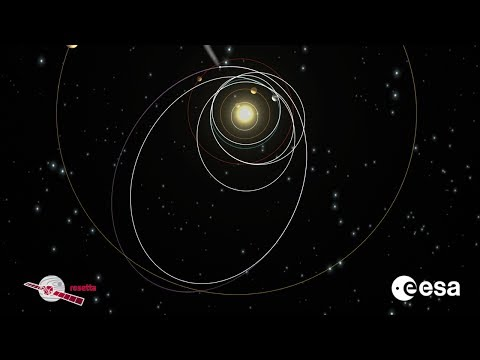

In [9]:
YouTubeVideo('iEQuE5N3rwQ', width=800, height=500)

---
## Useful Links

If you would like to further explore Python and fractals you may find the following links useful:

- [Anaconda](https://www.anaconda.com/products/distribution) - a suite of software tools that includes Jupyter Notebook and Python. Download and install on your computer to write and run Jupyter notebooks
- [Google Colab](https://colab.research.google.com/) - run Jupyter notebooks in the cloud using Google Colab (you will need to have a Google account to do this)
- [Chaos Theory](https://en.wikipedia.org/wiki/Chaos_theory)
- [Double Pendulum](https://en.wikipedia.org/wiki/Double_pendulum)
- [n-body Problem](https://en.wikipedia.org/wiki/N-body_problem)

&copy; Dr Jon Shiach 2022